Libraries 

In [ ]:
from keras.layers import Input, Lambda, Dense, Flatten
from keras.models import Model
from keras.applications.vgg16 import VGG16
from keras.applications.vgg16 import preprocess_input
from keras.preprocessing import image
from keras.preprocessing.image import ImageDataGenerator
from keras.models import Sequential
import numpy as np
from glob import glob
import matplotlib.pyplot as plt
from PIL import Image
from google.colab.patches import cv2_imshow
import cv2
import os
# re-size all the images to this
IMAGE_SIZE = [224, 224]

Downloading Training Set

In [ ]:
!gdown https://drive.google.com/u/0/uc?id=1wPPzqPx5um8MXqze-7tHhJdtEnj19Vuz&export=download

Downloading...
From: https://drive.google.com/u/0/uc?id=1wPPzqPx5um8MXqze-7tHhJdtEnj19Vuz
To: /content/data.zip
2.63MB [00:00, 83.5MB/s]


In [ ]:
!unzip "/content/data.zip"

Archive:  /content/data.zip
   creating: data/train/
   creating: data/train/ben_afflek/
  inflating: data/train/ben_afflek/httpcsvkmeuaeccjpg.jpg  
  inflating: data/train/ben_afflek/httpimagesfandangocomrImageRendererredesignstaticimgnoxportraitjpgpcpcpcimagesmasterrepositoryperformerimagespjpg.jpg  
  inflating: data/train/ben_afflek/httpssmediacacheakpinimgcomxdbbdbbbececacdecdcdfjpg.jpg  
  inflating: data/train/ben_afflek/httpssmediacacheakpinimgcomxdfdfadcfeabjpg.jpg  
  inflating: data/train/ben_afflek/httpssmediacacheakpinimgcomxedaedabcbefbcbabbjpg.jpg  
  inflating: data/train/ben_afflek/httpssmediacacheakpinimgcomxeebdfdbaaajpg.jpg  
  inflating: data/train/ben_afflek/httpssmediacacheakpinimgcomxeeedcacddeccccacfjpg.jpg  
  inflating: data/train/ben_afflek/httpsuploadwikimediaorgwikipediacommonsthumbddBenAffleckbyGageSkidmorejpgpxBenAffleckbyGageSkidmorejpg.jpg  
  inflating: data/train/ben_afflek/httptrwebimgacstanetcxbdddmediasnmediajpg.jpg  
  inflating: data/train/ben_a

In [ ]:
train_path = '/content/data/train/'
valid_path = '/content/data/val/'


Preprocess the train and validation images

In [ ]:
face_cascade = cv2.CascadeClassifier('haarcascade_frontalface_default.xml')
def face_extractor(img):
    # Function detects faces and returns the cropped face
    # If no face detected, it returns the input image
    
    #gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    faces = face_cascade.detectMultiScale(img, 1.3, 5)
    
    if faces is ():
        return None
    
    # Crop all faces found
    for (x,y,w,h) in faces:
        x=x-10
        y=y-10
        cropped_face = img[y:y+h+50, x:x+w+50]

    return cropped_face

For Train Set

/content/data/train/elton_john/httpssmediacacheakpinimgcomxfcfcbaeaeddabbjpg.jpg


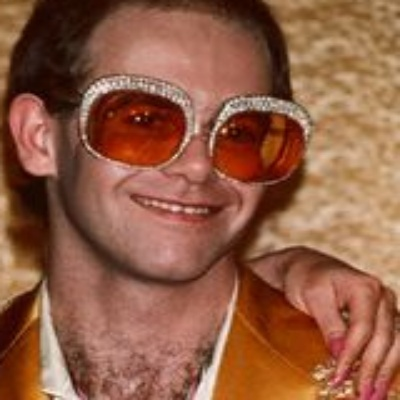

/content/data/train/elton_john/httpimagesmtvcomurimgidfiledocrootvhcomsitewideflipbooksimgdailyjpgenlargefalsemattetruematteColorblackquality.jpg


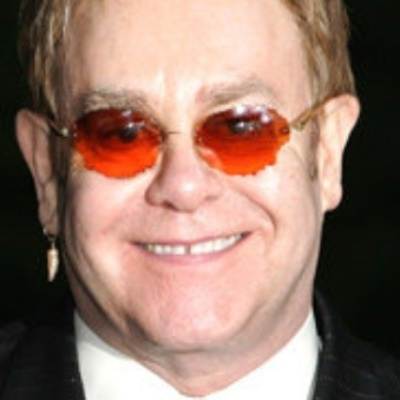

/content/data/train/elton_john/httpmediapopsugarassetscomfilescbffewltonjpg.jpg


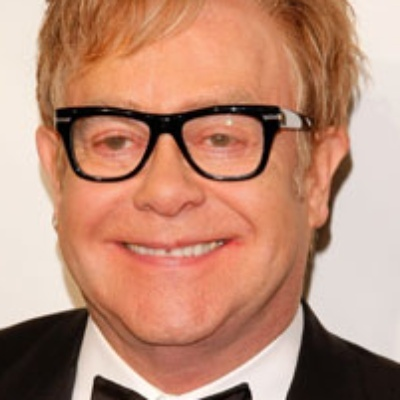

/content/data/train/elton_john/httpsticketmnettmenusdamabbacdaebeafdbbCUSTOMjpg.jpg


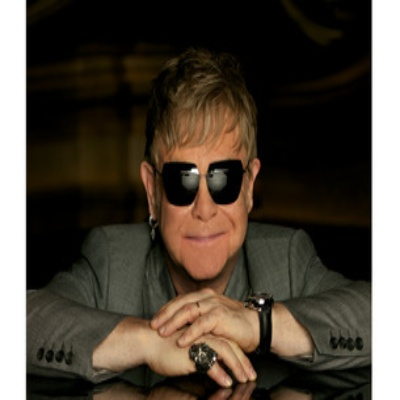

/content/data/train/elton_john/httpsuploadwikimediaorgwikipediacommonsthumbEltonJohninsjpgpxEltonJohninsjpg.jpg


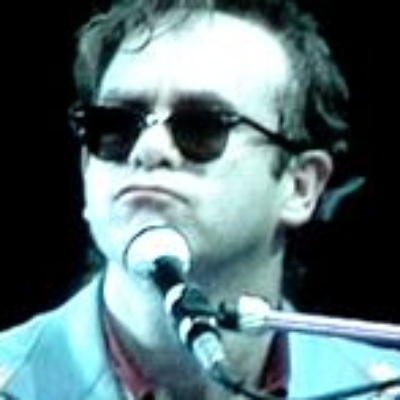

/content/data/train/elton_john/httpwwwjohnpauljonesarenacomeventimagesEltonCalendarVjpg.jpg


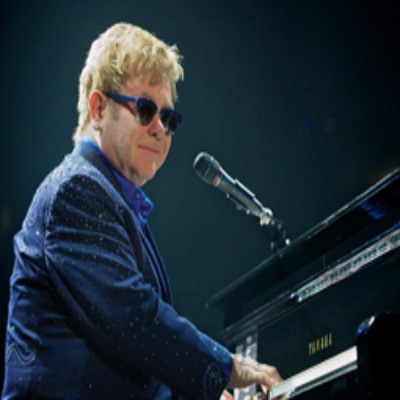

/content/data/train/elton_john/httpwwwlautdeEltonJohneltonjohnjpg.jpg


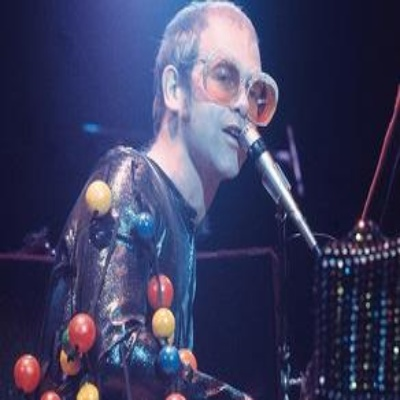

/content/data/train/elton_john/httpwwwdeadlinecomvimgnetwpcontentuploadseltonjpg.jpg


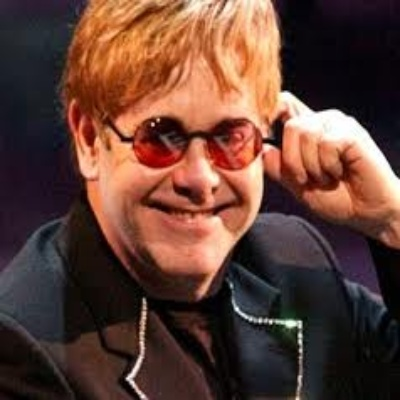

/content/data/train/elton_john/httpsdfrpwlycscloudfrontnetdeltonjohnjpg.jpg


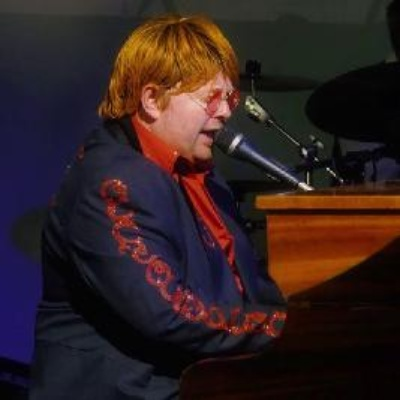

/content/data/train/elton_john/httpssmediacacheakpinimgcomxfefdacfbfdeadajpg.jpg


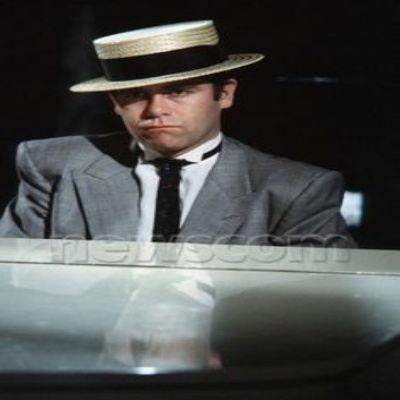

/content/data/train/elton_john/httpmediacacheecpinimgcomxffeffbcefjpg.jpg


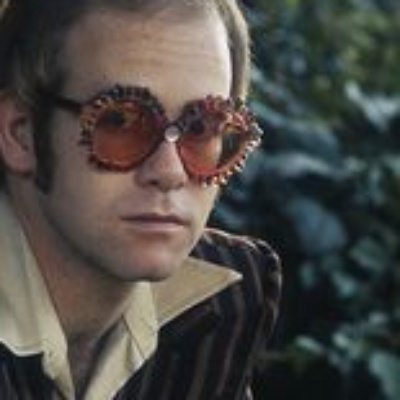

/content/data/train/elton_john/httpspmctvlinefileswordpresscomeltonjohnjpg.jpg


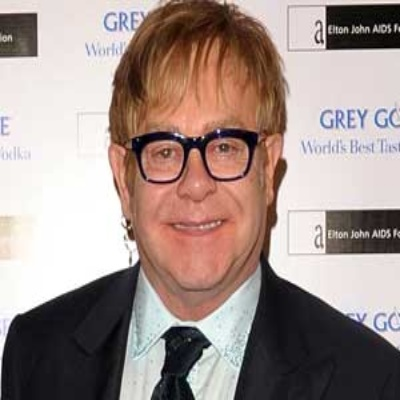

/content/data/train/elton_john/httpftqncomymusicLxZeltonjohnjpg.jpg


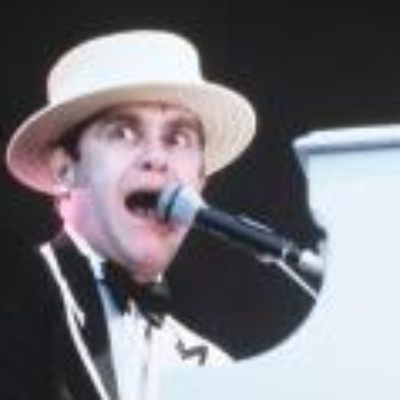

/content/data/train/elton_john/httpssmediacacheakpinimgcomxfecfecaefaadfebejpg.jpg


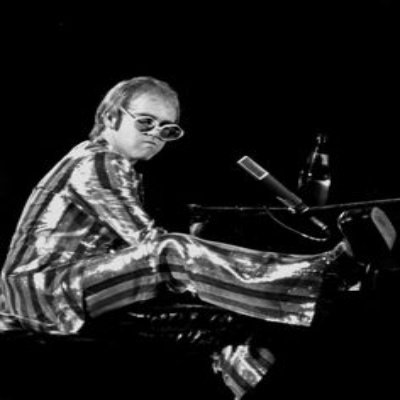

/content/data/train/elton_john/httpiamediaimdbcomimagesMMVBMTAxNDUMzUwOTdeQTJeQWpwZBbWUMDUOTAyNTIVUXCRALjpg.jpg


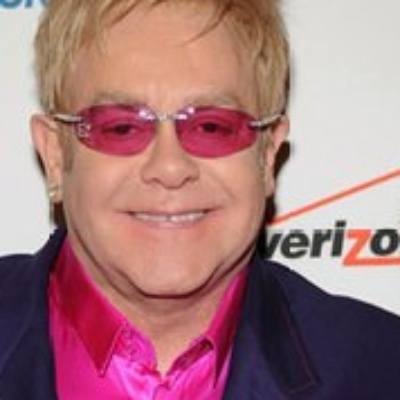

/content/data/train/elton_john/httpimggalpmdstaticnetfithttpAFFwwwEgalaEfrFvarFgalFstorageFimagesFmediaFmultiuploaddufevrierFeltonjohnFfreFRFeltonjohnEjpgxqualityeltonjohnjpg.jpg


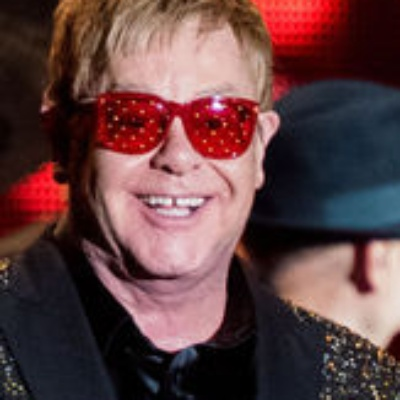

/content/data/train/elton_john/httpwwweonlinecomresizewwweonlinecomeolimagesEntireSitersxEltonJohnJRjpg.jpg


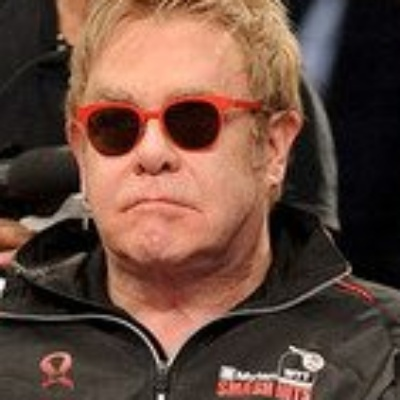

/content/data/train/madonna/httpssmediacacheakpinimgcomxffabffabbbcfbceaedjpg.jpg


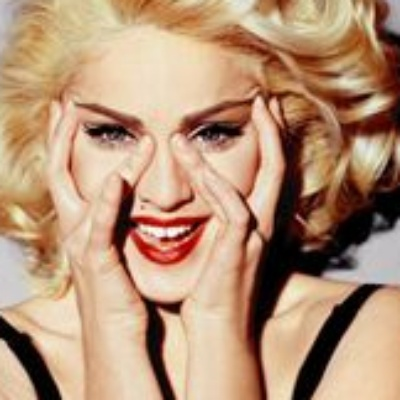

/content/data/train/madonna/httpsuploadwikimediaorgwikipediacommonsthumbaaMadonnaatthepremiereofIAmBecauseWeArejpgpxMadonnaatthepremiereofIAmBecauseWeArejpg.jpg


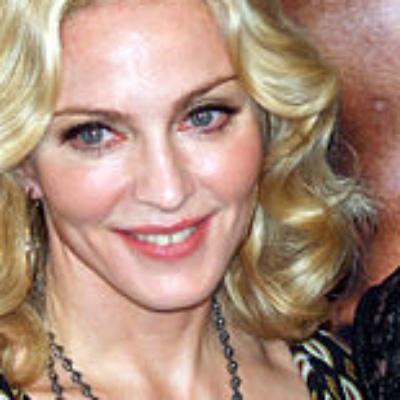

/content/data/train/madonna/httpmediavoguecomrwblondesdarkbrowsmadonnajpg.jpg


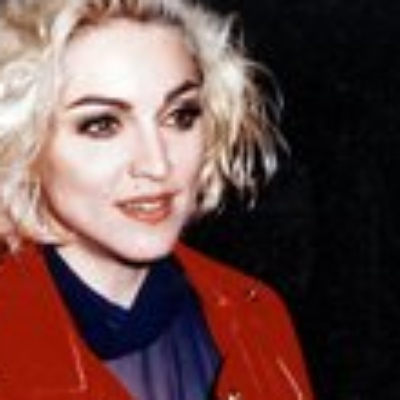

/content/data/train/madonna/httpssmediacacheakpinimgcomxafafedebcbjpg.jpg


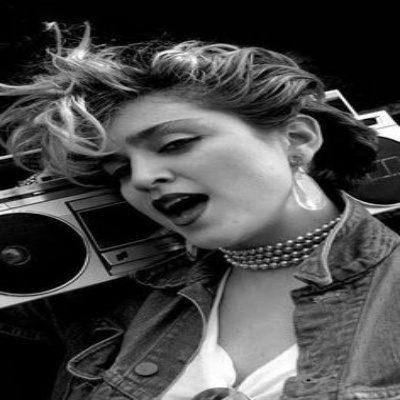

/content/data/train/madonna/httpwwwetonlinecomphotomadonnabdayjpg.jpg


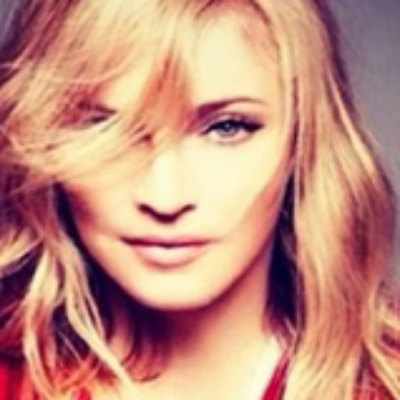

/content/data/train/madonna/httpssmediacacheakpinimgcomxffeabacaaejpg.jpg


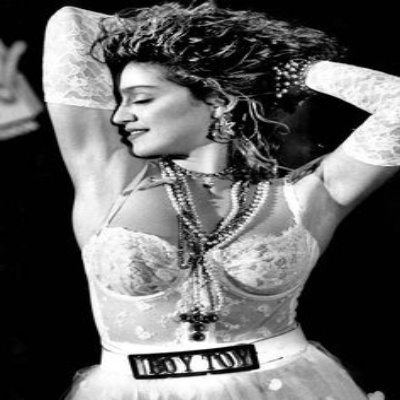

/content/data/train/madonna/httpssmediacacheakpinimgcomxaaeaaeecccaedfebdbjpg.jpg


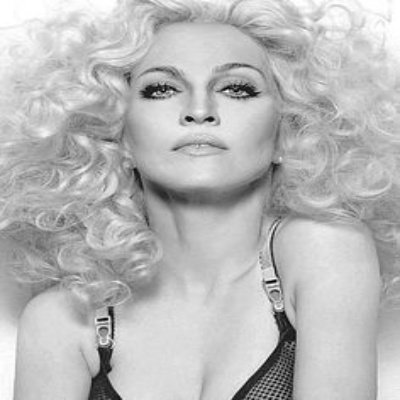

/content/data/train/madonna/httpimgclosermagfrvarclosermagstorageimagesactupeoplebiodestarsmadonnamadonnafreFRmadonnaexactxljpg.jpg


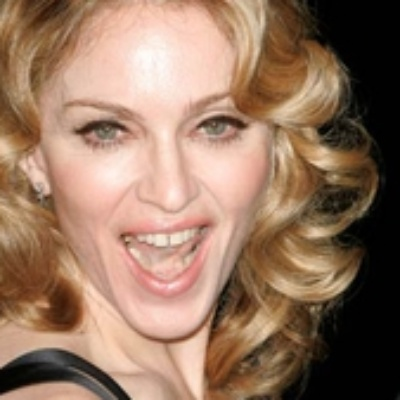

/content/data/train/madonna/httpwwwblackdogfilmscomwordpresswpcontentuploadsmadonnacelebrationxjpg.jpg


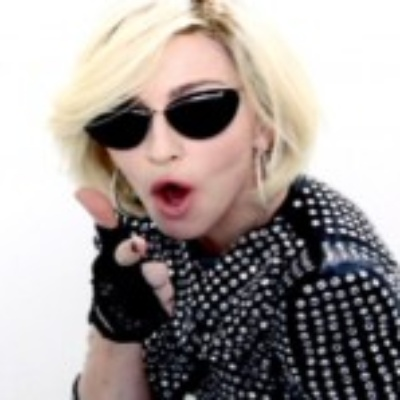

/content/data/train/madonna/httpssmediacacheakpinimgcomxdcfdcfedfaedadjpg.jpg


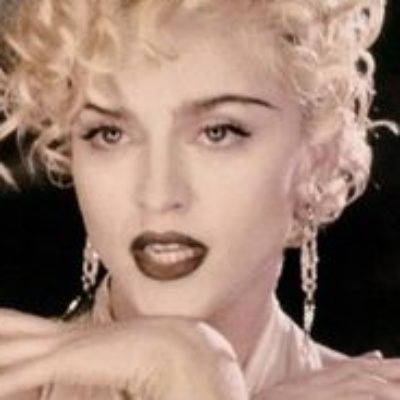

/content/data/train/madonna/httpresizeparismatchladmediafrrffffffcentermiddleimgvarnewsstorageimagesparismatchpeopleazmadonnafreFRMadonnajpg.jpg


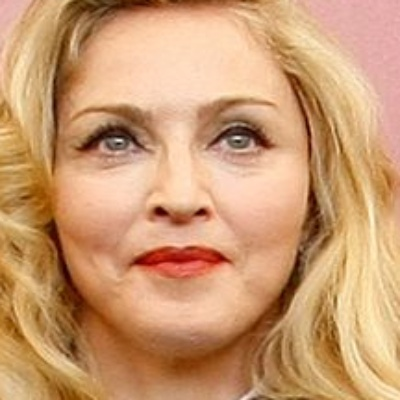

/content/data/train/madonna/httpimagegaladevcmseamadonnaprivatdetektivsquaretopsquarejpgv.jpg


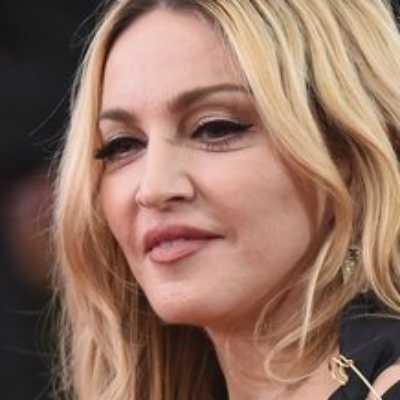

/content/data/train/madonna/httpssmediacacheakpinimgcomxffecfafddjpg.jpg


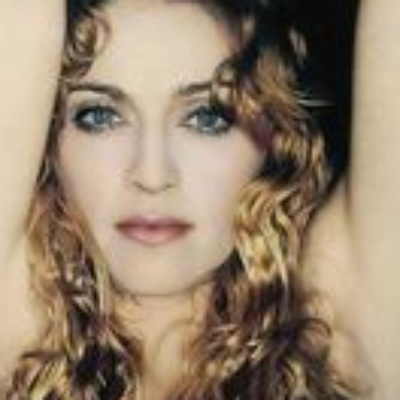

/content/data/train/madonna/httpuploadwikimediaorgwikipediacommonsthumbaMadonnaRotterdamjpgpxMadonnaRotterdamjpg.jpg


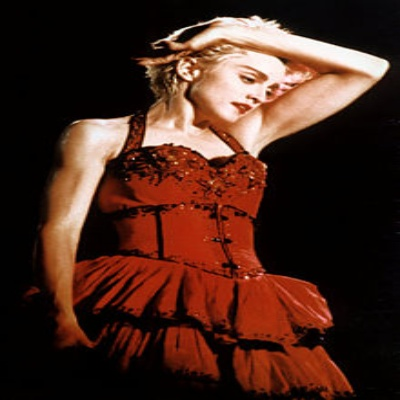

/content/data/train/madonna/httpssmediacacheakpinimgcomxfeebfdccajpg.jpg


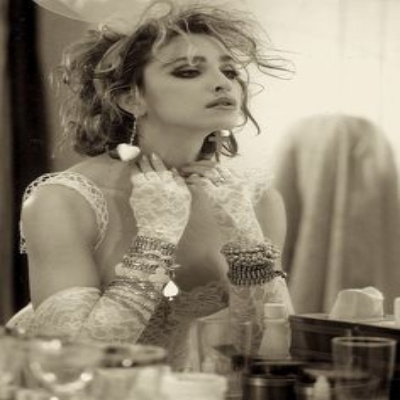

/content/data/train/madonna/httpwwwbeastiemaniacomwhoismadonnamadonnajpg.jpg


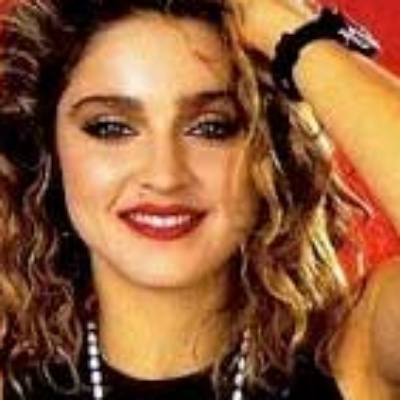

/content/data/train/madonna/httpsuploadwikimediaorgwikipediacommonsMadonnathAnnualGoldenGlobesAwardscroppedjpg.jpg


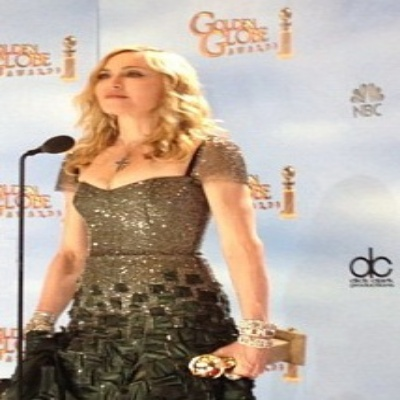

/content/data/train/madonna/httpssvagalumecommadonnaimagesmadonnajpg.jpg


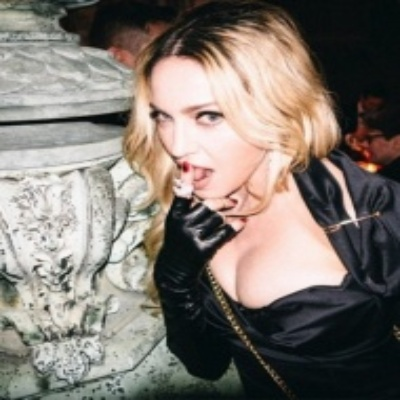

/content/data/train/madonna/httpiamediaimdbcomimagesMMVBMTANDQNTAxNDVeQTJeQWpwZBbWUMDIMjQOTYVUXCRALjpg.jpg


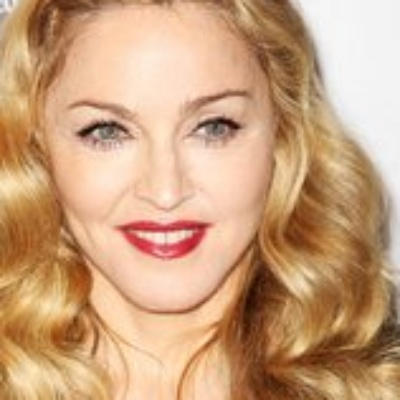

/content/data/train/jerry_seinfeld/httpsticketmnettmenusdbimagesajpg.jpg


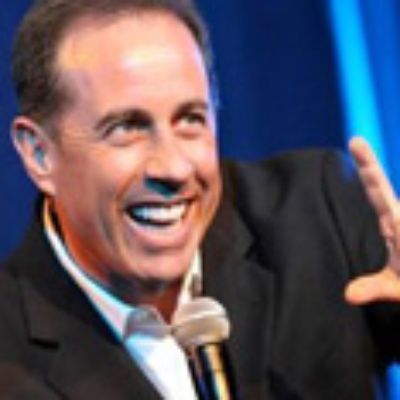

/content/data/train/jerry_seinfeld/httpikinjaimgcomgawkermediaimageuploadsWmIuhdsrcedidjpgjpg.jpg


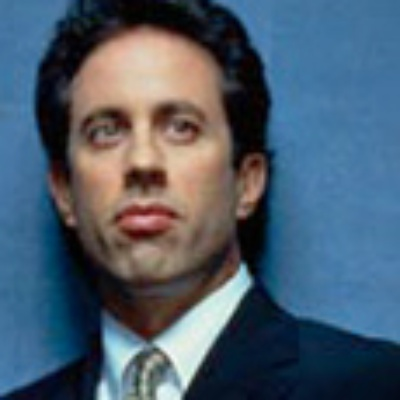

/content/data/train/jerry_seinfeld/httppfodcompchannelslegacyprofilejerryseinfeldpodcastjpg.jpg


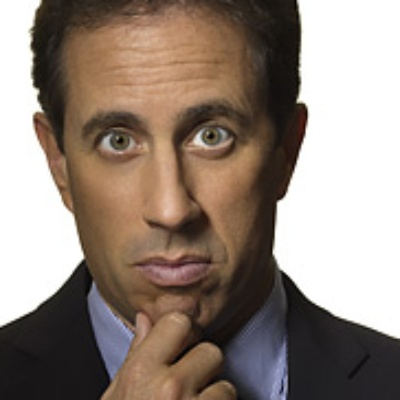

/content/data/train/jerry_seinfeld/httpmediapopsugarassetscomfilesusersxlargejpg.jpg


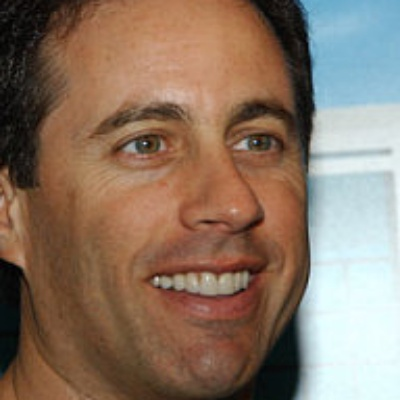

/content/data/train/jerry_seinfeld/httpwwwnndbcompeoplejerryseinfeldaujpg.jpg


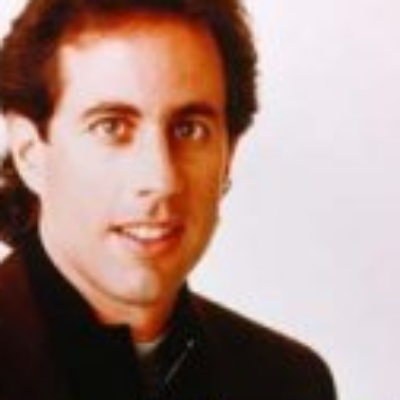

/content/data/train/jerry_seinfeld/httpwwwpsychiatrictimescomsitesdefaultfilesimagesmediaPTMofficSeinfeldjpg.jpg


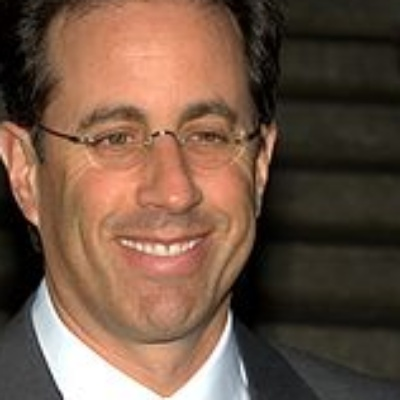

/content/data/train/jerry_seinfeld/httpimgthedrumcomsfspublicnewstmpjerryseinfeldjpg.jpg


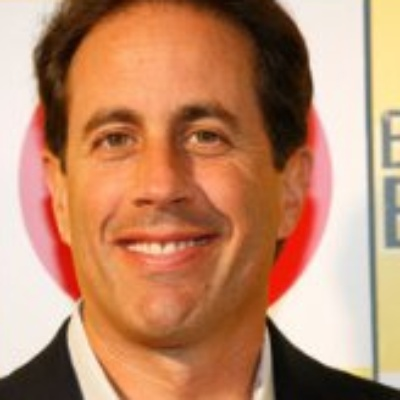

/content/data/train/jerry_seinfeld/httpwwweonlinecomresizewwweonlinecomeolimagesEntireSitersxjerryseinfeldjulialouisdreyfusjwjpg.jpg


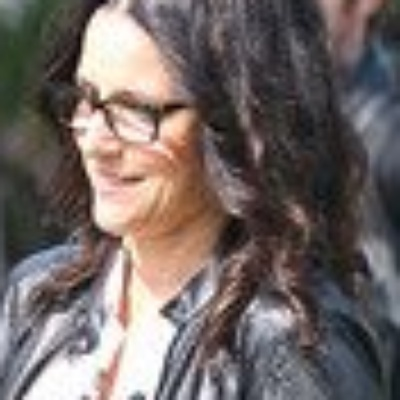

/content/data/train/jerry_seinfeld/httpstatictherichestimagescomcdncwpcontentuploadsJerrySeinfeldjpg.jpg


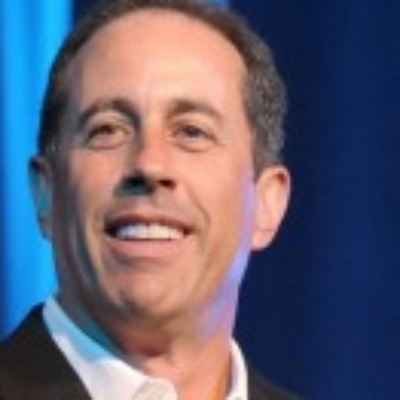

/content/data/train/jerry_seinfeld/httpgraphicsnytimescomimagessectionmoviesfilmographyWireImagejpg.jpg


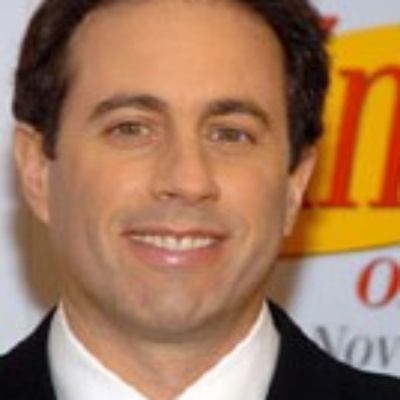

/content/data/train/jerry_seinfeld/httpimgtimeincnetpeopleinewsjerryseinfeldjpg.jpg


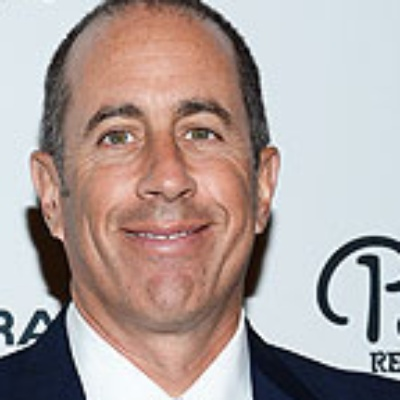

/content/data/train/jerry_seinfeld/httpwwwslatecomcontentdamslateblogsbrowbeatseinfeldjpgCROParticlemediumjpg.jpg


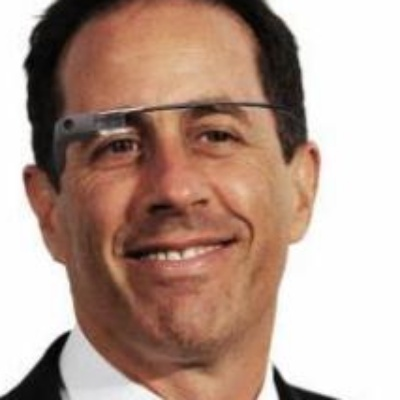

/content/data/train/jerry_seinfeld/httpsmedialivenationcomartiststapjpg.jpg


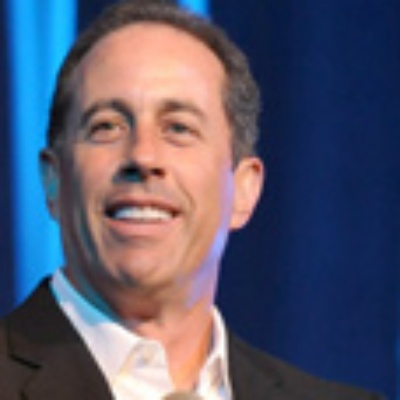

/content/data/train/jerry_seinfeld/httpswwwticketscomuploadsartistsjerryseinfeldbilletsjpg.jpg


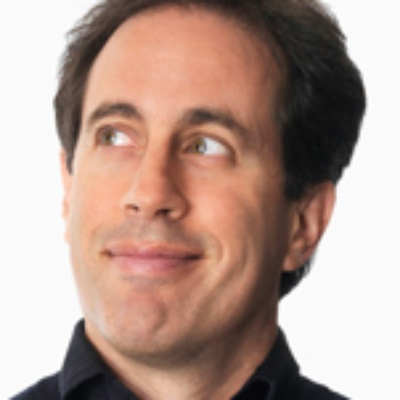

/content/data/train/jerry_seinfeld/httpsuswestamazonawscomblogsprodmediausuploadsJerrySeinfeldkidsxjpg.jpg


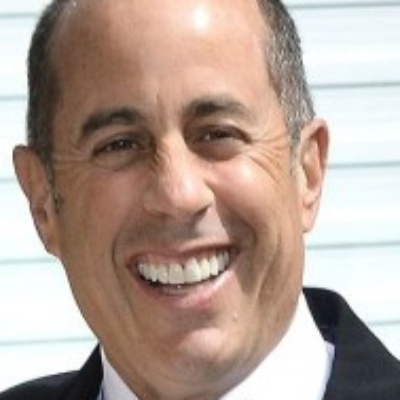

/content/data/train/jerry_seinfeld/httpwwwwatchidcomsitesdefaultfilesuploadsightingBreitlingwatchJerrySeinfeldjpg.jpg


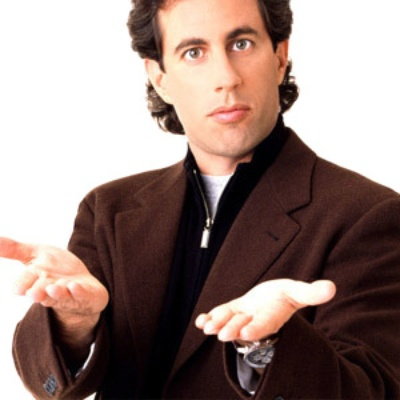

/content/data/train/jerry_seinfeld/httpimagesrottentomatoescomimagesspotlightsnewsjerryseinfeldjpg.jpg


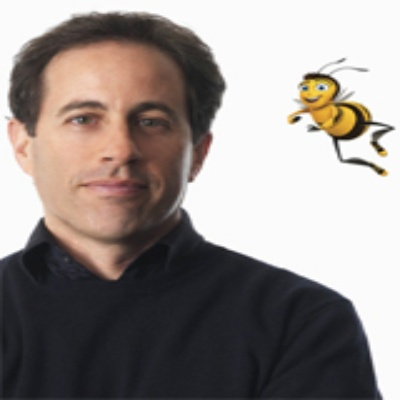

/content/data/train/jerry_seinfeld/httpimagescontactmusiccomnewsimagesjerryseinfeldjpg.jpg


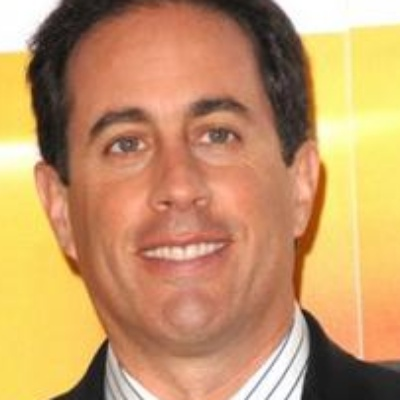

/content/data/train/jerry_seinfeld/httpsrobertaccetturacomwpcontentuploadsjerryseinfeldheadshotjpg.jpg


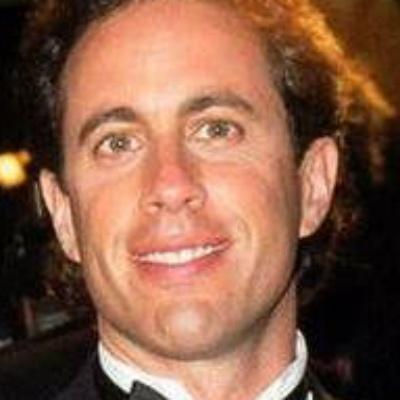

/content/data/train/jerry_seinfeld/httpsuploadwikimediaorgwikipediacommonsthumbbJerrySeinfeldjpgpxJerrySeinfeldjpg.jpg


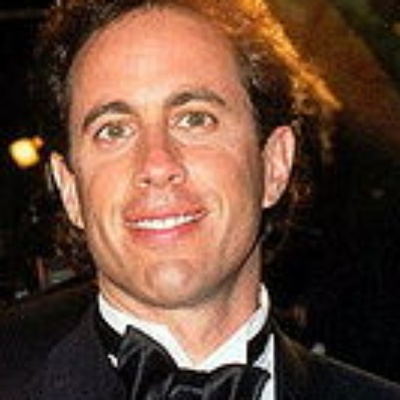

/content/data/train/jerry_seinfeld/httpwwwpictureszimbiocomgpJerrySeinfeldJessicaSeinfeldmarriedBczSipMdNMQljpg.jpg


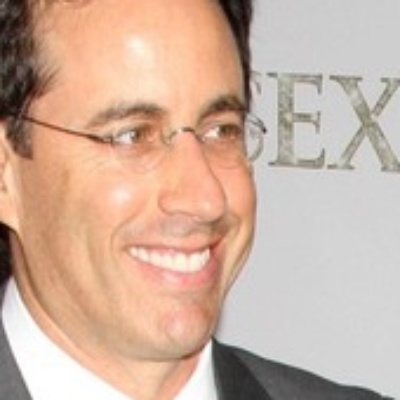

/content/data/train/ben_afflek/httpcsvkmeuaeccjpg.jpg


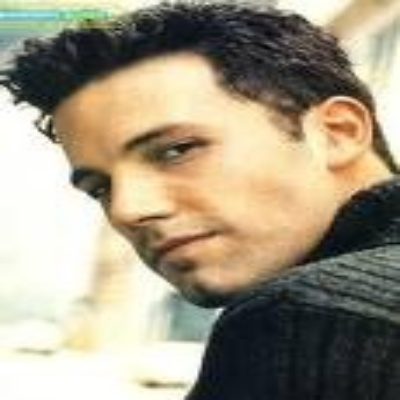

/content/data/train/ben_afflek/httpwwwhillsindcomstorebenjpg.jpg


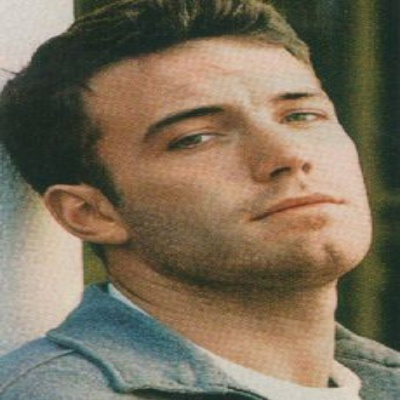

/content/data/train/ben_afflek/httpssmediacacheakpinimgcomxdbbdbbbececacdecdcdfjpg.jpg


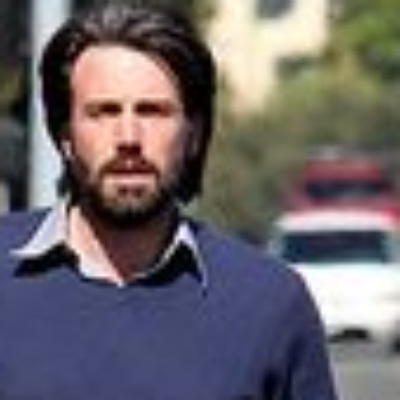

/content/data/train/ben_afflek/httpssmediacacheakpinimgcomxedaedabcbefbcbabbjpg.jpg


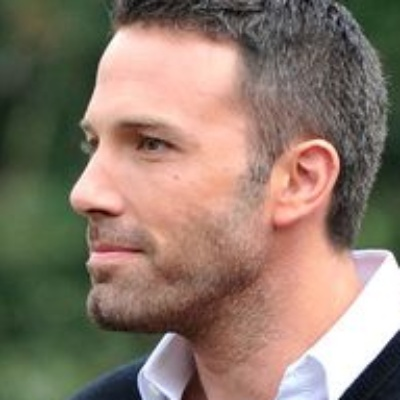

/content/data/train/ben_afflek/httpwwwrumenewscomwpcontentuploadsbenafflekxpng.jpg


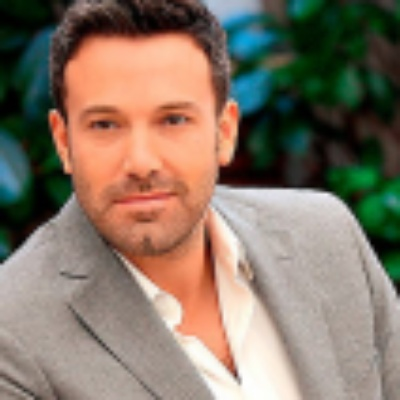

/content/data/train/ben_afflek/httpssmediacacheakpinimgcomxeeedcacddeccccacfjpg.jpg


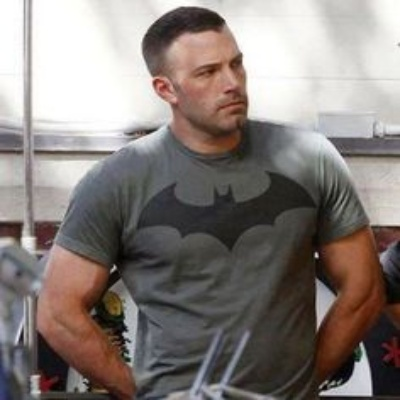

/content/data/train/ben_afflek/httpimagesfandangocomrImageRendererredesignstaticimgnoxportraitjpgpcpcpcimagesmasterrepositoryperformerimagespjpg.jpg


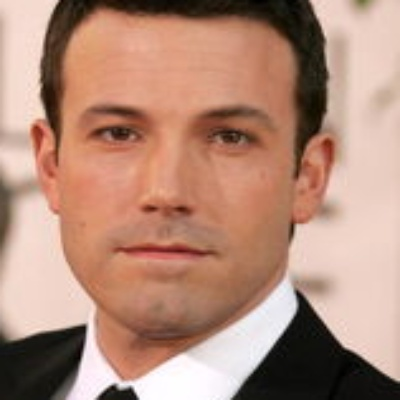

/content/data/train/ben_afflek/httptrwebimgacstanetcxbdddmediasnmediajpg.jpg


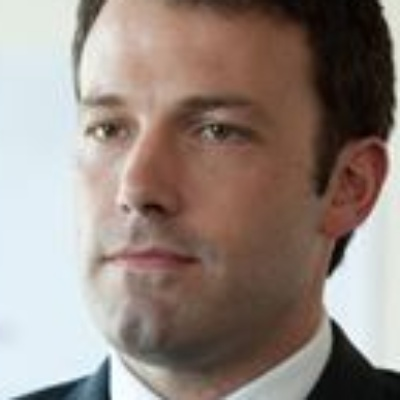

/content/data/train/ben_afflek/httpwwwallposterscomimagesPostersPFjpg.jpg


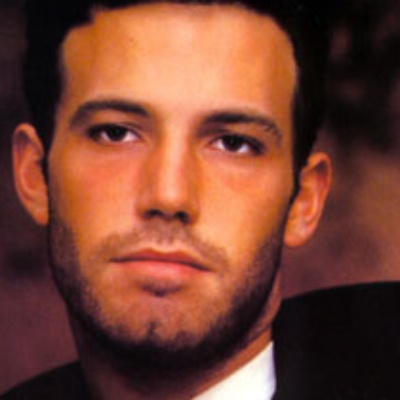

/content/data/train/ben_afflek/httpsuploadwikimediaorgwikipediacommonsthumbddBenAffleckbyGageSkidmorejpgpxBenAffleckbyGageSkidmorejpg.jpg


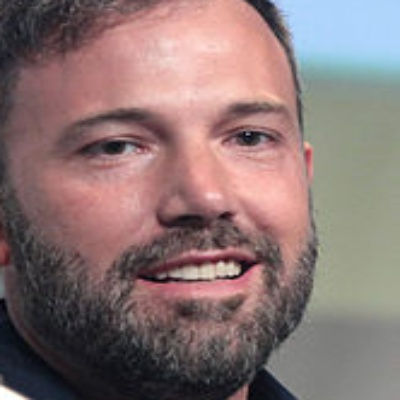

/content/data/train/ben_afflek/httpssmediacacheakpinimgcomxdfdfadcfeabjpg.jpg


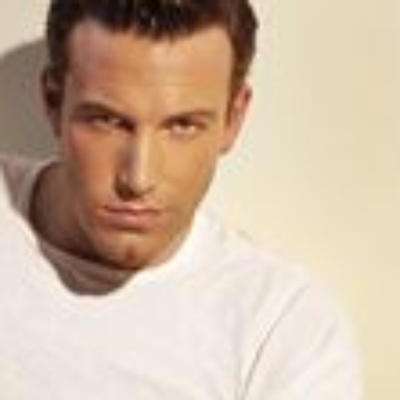

/content/data/train/ben_afflek/httpssmediacacheakpinimgcomxeebdfdbaaajpg.jpg


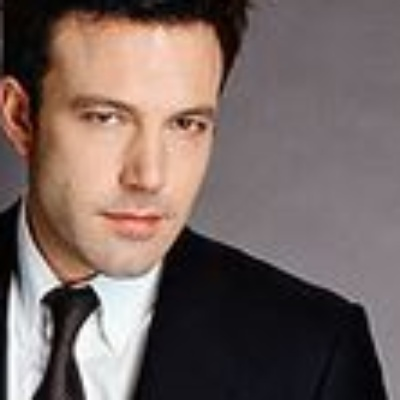

/content/data/train/ben_afflek/httpwwwfilmscoopitcgibinattoriBENAFFLECKBENAFFLECKjpg.jpg


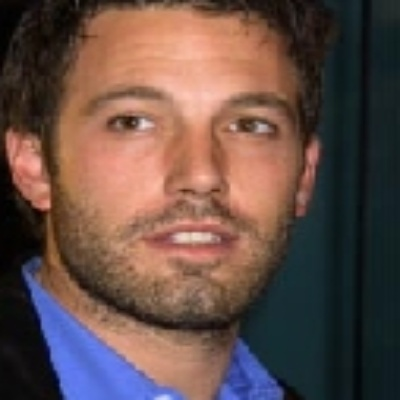

/content/data/train/ben_afflek/httpwwwaceshowbizcomimagesphotobenaffleckjpg.jpg


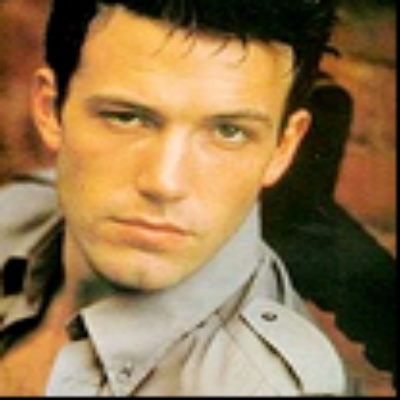

/content/data/train/mindy_kaling/httpsamazonawscomkidzworldphotoimagesbccdddaaadgallerymindykalinggalleryjpg.jpg


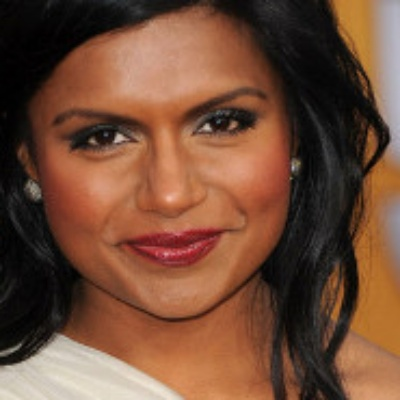

/content/data/train/mindy_kaling/httpssmediacacheakpinimgcomxededbebccdajpg.jpg


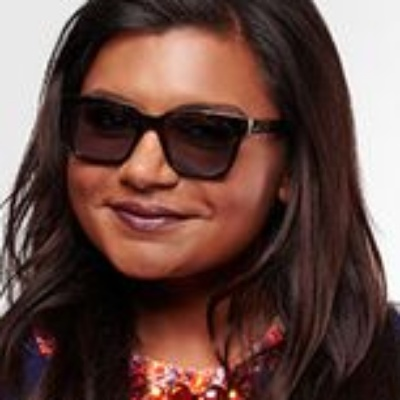

/content/data/train/mindy_kaling/httpssmediacacheakpinimgcomxccccdabeaadjpg.jpg


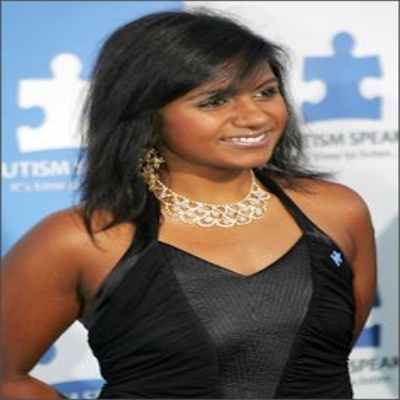

/content/data/train/mindy_kaling/httpsimgbuzzfeedcombuzzfeedstaticstaticcampaignimageswebdradorableetsyitemsallmindykalingfansneedbigjpg.jpg


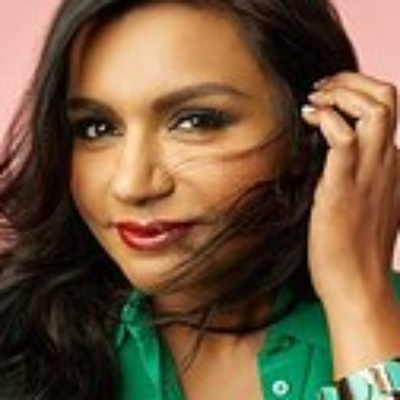

/content/data/train/mindy_kaling/httpgonetworthcomwpcontentuploadsthumbsjpg.jpg


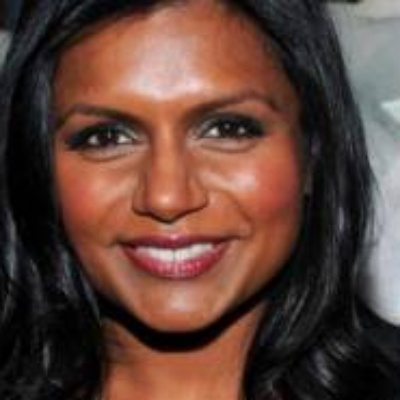

/content/data/train/mindy_kaling/httpgraphicsnytimescomimagesmagazinekalingkalingarticleInlinejpg.jpg


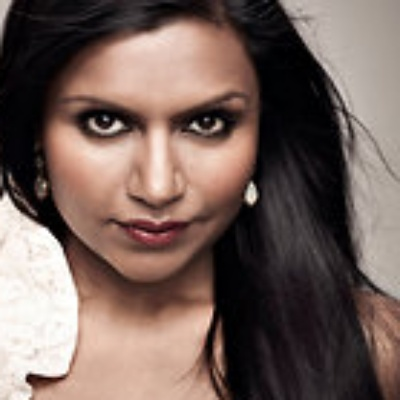

/content/data/train/mindy_kaling/httpssmediacacheakpinimgcomxeedccadejpg.jpg


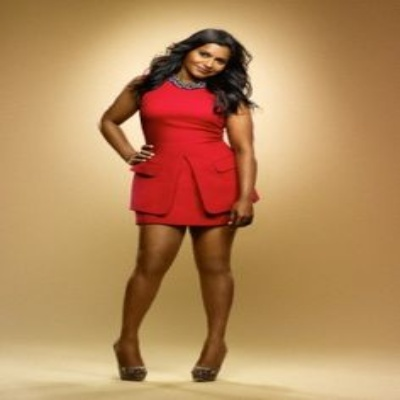

/content/data/train/mindy_kaling/httpssmediacacheakpinimgcomxbbfcbdedfbfdbjpg.jpg


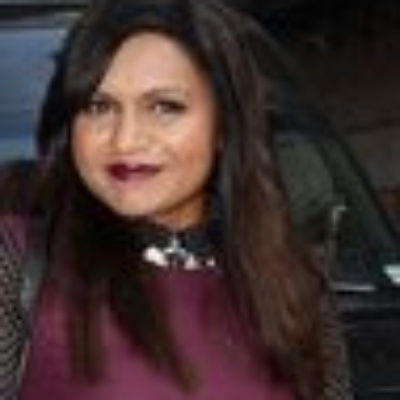

/content/data/train/mindy_kaling/httpssmediacacheakpinimgcomxbabafeacbaaacabffjpg.jpg


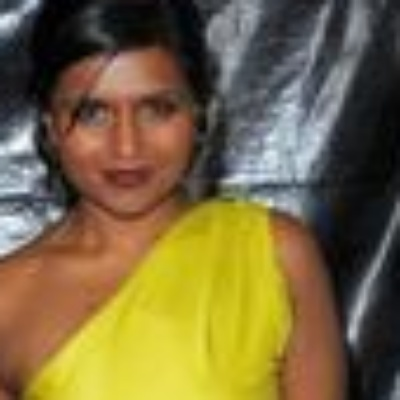

/content/data/train/mindy_kaling/httpimagesnymagcomimagesdailymindykalingxjpg.jpg


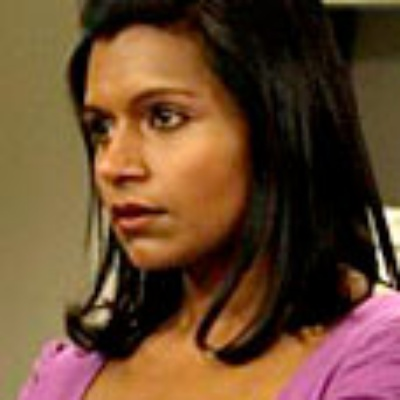

/content/data/train/mindy_kaling/httpsimagesnasslimagesamazoncomimagesIAQdwKvFILUXjpg.jpg


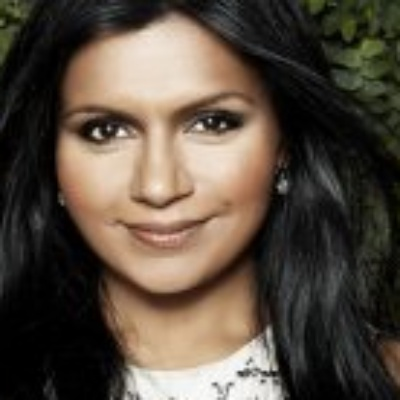

/content/data/train/mindy_kaling/httpsuploadwikimediaorgwikipediacommonsthumbMindyBKalingBPaleyFestBNewBYorkBBMindyBIqZgUWvbljpgpxMindyBKalingBPaleyFestBNewBYorkBBMindyBIqZgUWvbljpg.jpg


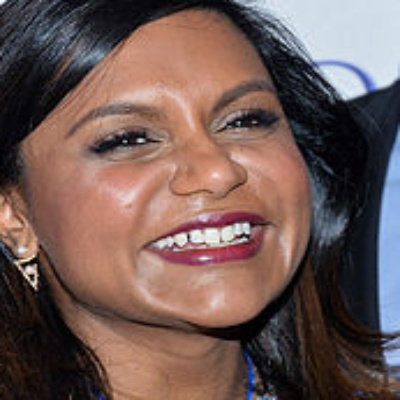

/content/data/train/mindy_kaling/httpwwwimpropercomimagesuploadsusercontentimagesSoroffMindyjpg.jpg


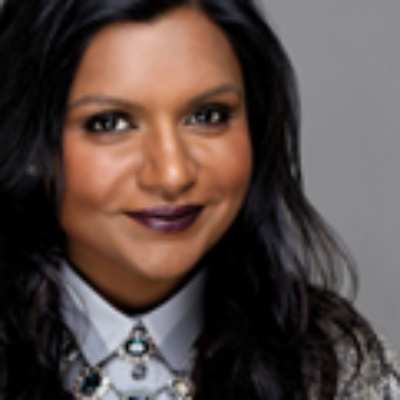

/content/data/train/mindy_kaling/httpwwwadweekcomfilesimagecachenodeinlinemindykalingprofilehedjpg.jpg


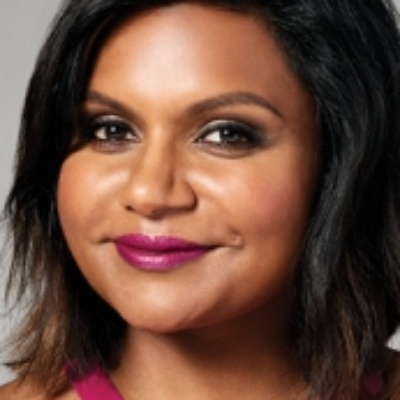

/content/data/train/mindy_kaling/httppixelnymagcomimgsfashiondailymindykalingwhjpg.jpg


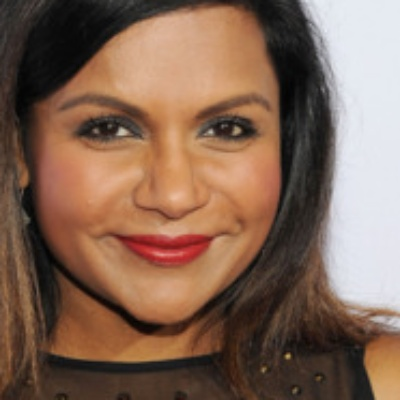

/content/data/train/mindy_kaling/httpwwwbooksforbetterlivingcomwpcontentuploadsMindyKalingAuthorPhotojpg.jpg


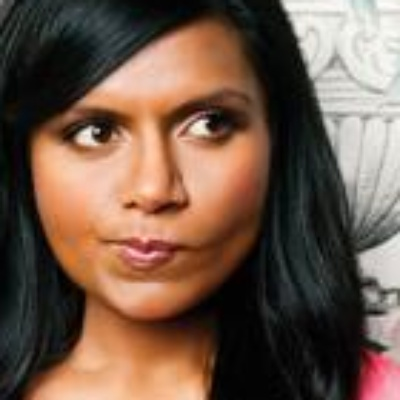

/content/data/train/mindy_kaling/httpmediaonsugarcomfilesbabaaaaaMindyInterviewxxxlargejpg.jpg


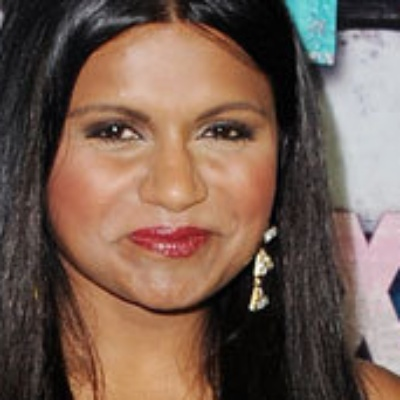

/content/data/train/mindy_kaling/httpwwwpictureszimbiocomgiMindyKalingLkvEhTwDeJmjpg.jpg


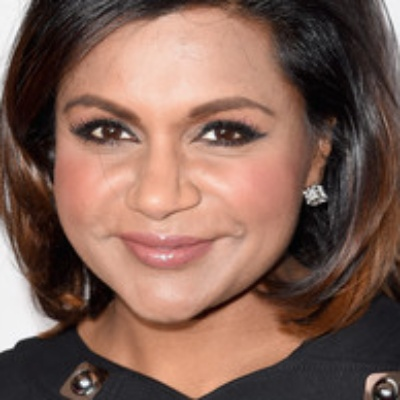

/content/data/train/mindy_kaling/httpssmediacacheakpinimgcomxafaffbbbbdbcbdddjpg.jpg


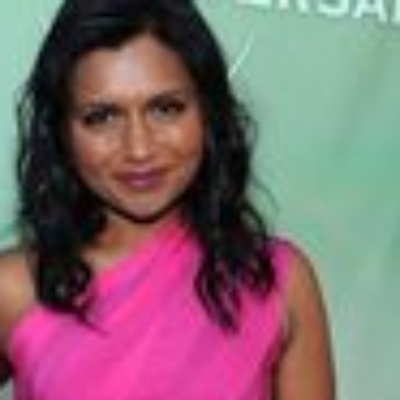

/content/data/train/mindy_kaling/httpwwweonlinecomeolimagesEntireSiteregKalingCancermhjpg.jpg


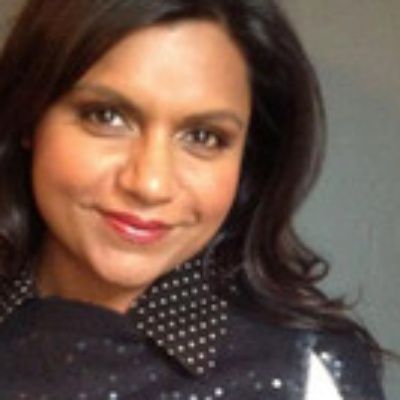

/content/data/train/mindy_kaling/httpwwwpictureszimbiocomfpMindyKalingfBgaONVFDFmjpg.jpg


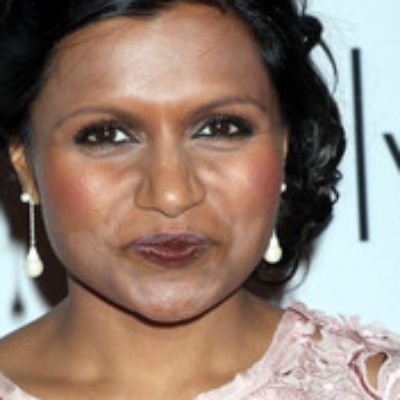

/content/data/train/mindy_kaling/httpssmediacacheakpinimgcomxcccccddbbfedabjpg.jpg


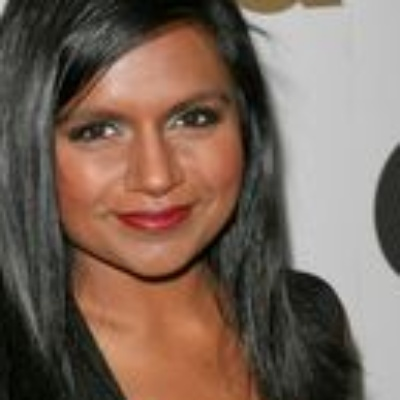

In [ ]:
for imgfolder in os.listdir(train_path): #iterate thru each of the 5 celeb folders
    for filename in os.listdir(train_path + imgfolder):# iterate thru each image in a celeb folder
        filename = train_path + imgfolder + '/' + filename # build the path to the image file
        print(filename) # print the filename read. For debugging purpose only
        img = cv2.imread(filename) # read the image using OpenCV
        try:
          face = cv2.resize(face_extractor(img), (400, 400))#extracting face from image if detected and resizing
        except:
          face = cv2.resize(img, (400, 400))#otherwise just resizing the image 
        cv2.imwrite(filename, face)
        img = cv2.imread(filename)#for showing images after the transformation
        cv2_imshow(img)

For Validation Set

/content/data/val/elton_john/httpcdncdnjustjaredcomwpcontentuploadsheadlineseltonjohnemmysperformancewatchnowjpg.jpg


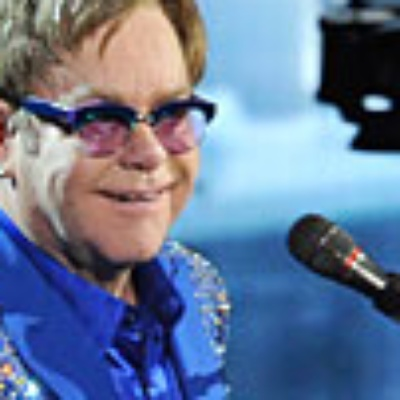

/content/data/val/elton_john/httpafilesbiographycomimageuploadcfillcssrgbdprgfacehqwMTEODAOTcxNjcMjczMjkzjpg.jpg


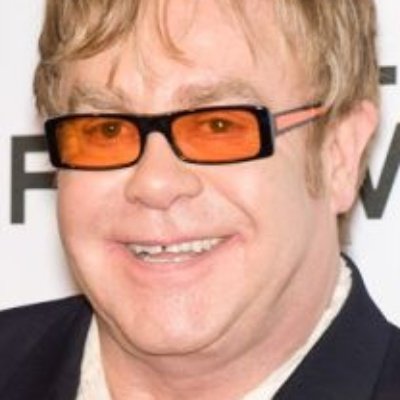

/content/data/val/elton_john/httpcdncdnjustjaredcomwpcontentuploadsheadlineseltonjohnstillstandingbrooklynnewyearsjpg.jpg


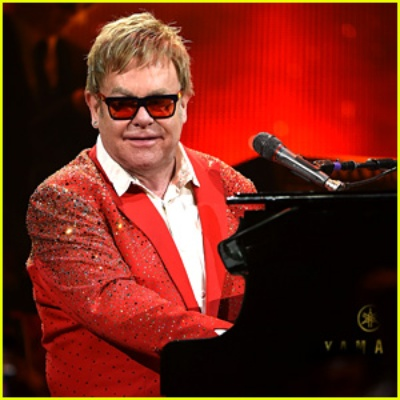

/content/data/val/elton_john/httpcdncdnjustjaredcomwpcontentuploadsheadlineseltonjohnsupportsbrucejennerstransitiontowomanjpg.jpg


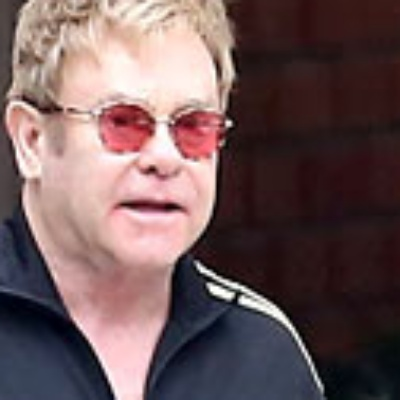

/content/data/val/elton_john/httpcdnlyricssongonlyricsnetwpcontentuploadsEltonJohnDiscographyCDreleasesjpg.jpg


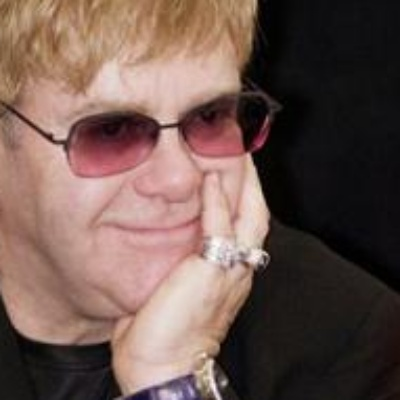

/content/data/val/madonna/httpassetsrollingstonecomassetsimagesalbumreviewaffaceabdcccaeedjpg.jpg


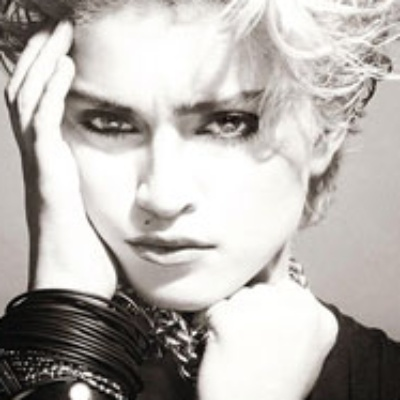

/content/data/val/madonna/httpassetsrollingstonecomassetsarticlemadonnadavidbowiechangedthecourseofmylifeforeversmallsquarexmadonnabowiejpg.jpg


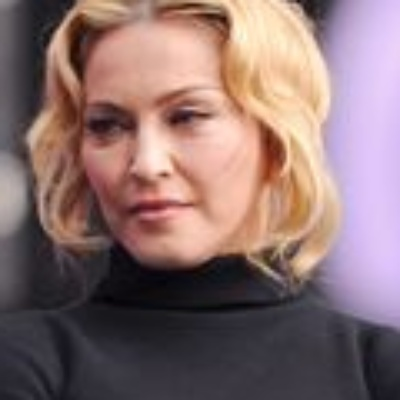

/content/data/val/madonna/httpcdnfuncheapcomwpcontentuploadsVOGUEjpg.jpg


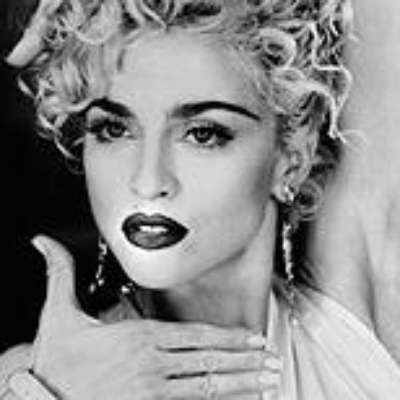

/content/data/val/madonna/httpecximagesamazoncomimagesIfmaBKWLACULSRjpg.jpg


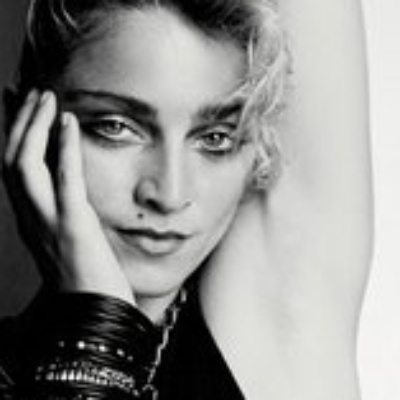

/content/data/val/madonna/httpcdncdnjustjaredcomwpcontentuploadsheadlinesmadonnatalksparisattackstearsjpg.jpg


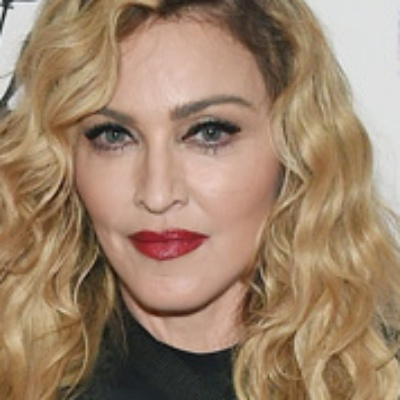

/content/data/val/jerry_seinfeld/httpcdncdnjustjaredcomwpcontentuploadsheadlinesjerryseinfeldmakesbrianwilliamsjokejpg.jpg


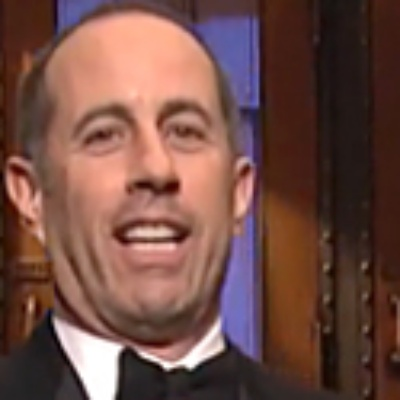

/content/data/val/jerry_seinfeld/httpcdnssninsidercomwpcontentuploadsjerryseinfeldxjpg.jpg


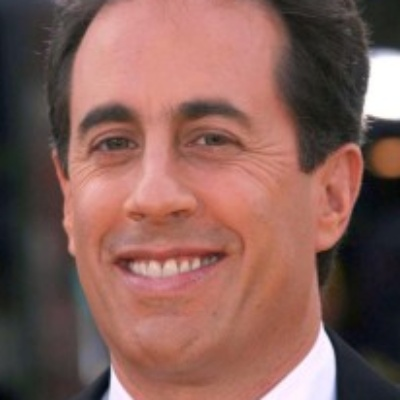

/content/data/val/jerry_seinfeld/httpblognjcomentertainmentimpactcelebritiesmediumjerrybjpg.jpg


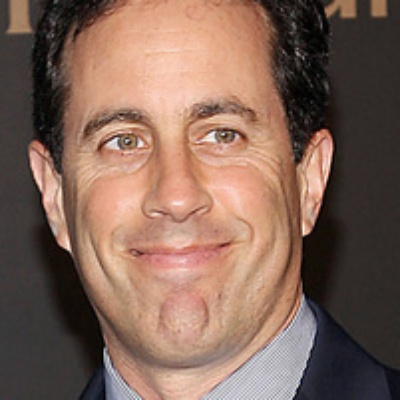

/content/data/val/jerry_seinfeld/httpafilesbiographycomimageuploadcfillcssrgbdprgfacehqwMTIwNjANjMMDINzIxNjcjpg.jpg


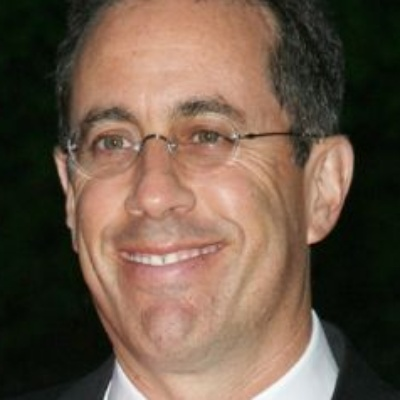

/content/data/val/jerry_seinfeld/httpaurorasblogcomwpcontentuploadsjerryseinfeldpublicityshotjpg.jpg


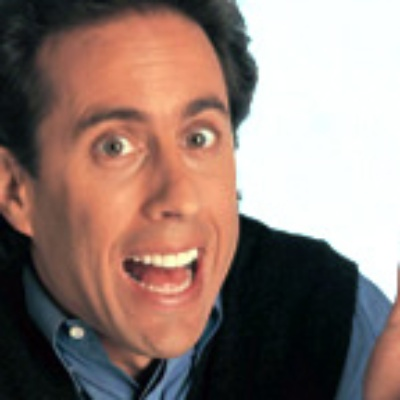

/content/data/val/ben_afflek/httpcsvkmeuadecafjpg.jpg


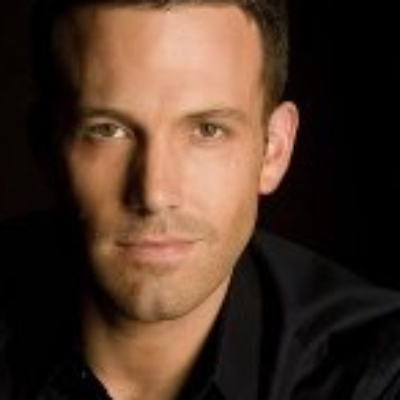

/content/data/val/ben_afflek/httpcsvkmeuaafdfjpg.jpg


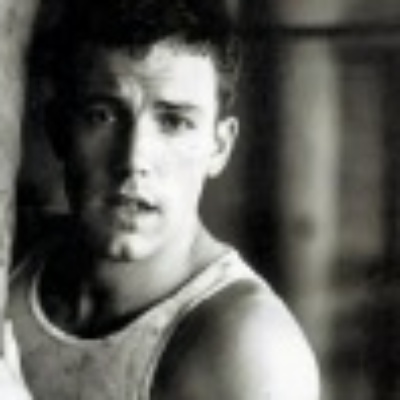

/content/data/val/ben_afflek/httpbpblogspotcomedLMjVpRGkSWexgsXjkNIAAAAAAAADWgFFtAUqBlhAsjpg.jpg


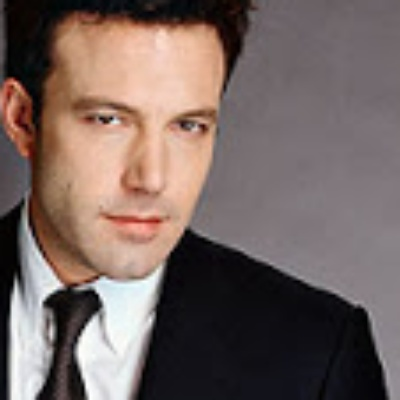

/content/data/val/ben_afflek/httpafilesbiographycomimageuploadcfillcssrgbdprgfacehqwMTENDgMDUODczNDcNTcjpg.jpg


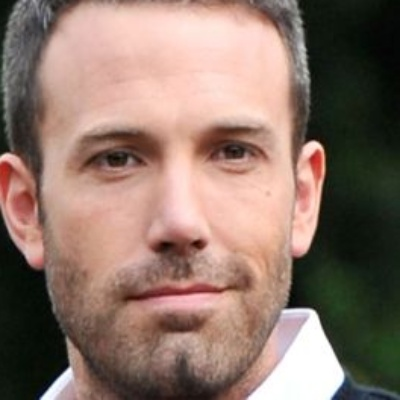

/content/data/val/ben_afflek/httpabsolumentgratuitfreefrimagesbenaffleckjpg.jpg


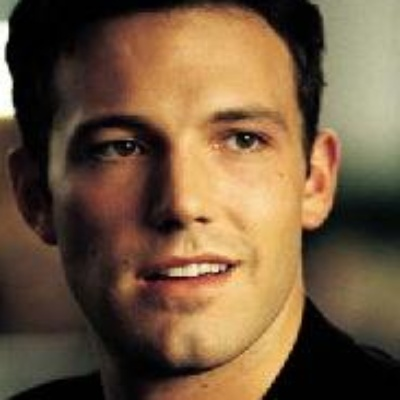

/content/data/val/mindy_kaling/httpafilesbiographycomimageuploadcfillcssrgbdprgfacehqwMTIOTcwODQNTUzNjQMzcjpg.jpg


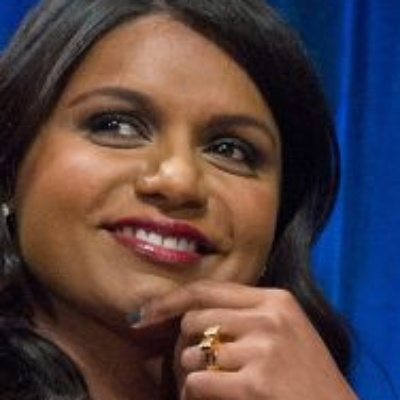

/content/data/val/mindy_kaling/httpcdnpastemagazinecomwwwarticlesmindykalingndbookjpg.jpg


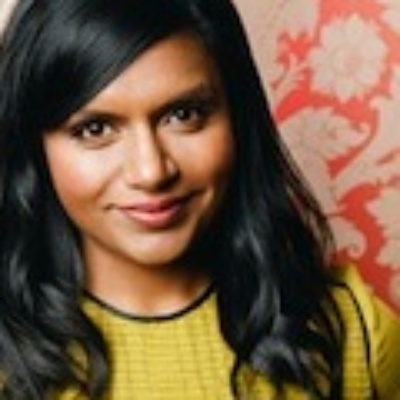

/content/data/val/mindy_kaling/httpcdnpastemagazinecomwwwarticlesmindyprojectjpg.jpg


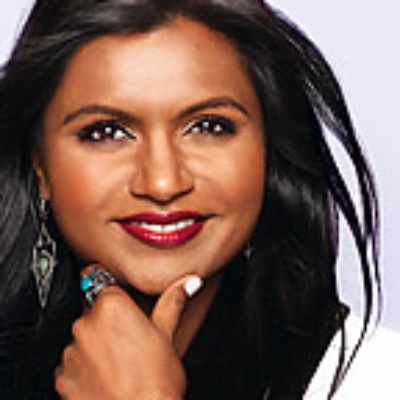

/content/data/val/mindy_kaling/httpdbrbzkkbdsdcloudfrontnetwpcontentuploadsMindyKalingjpg.jpg


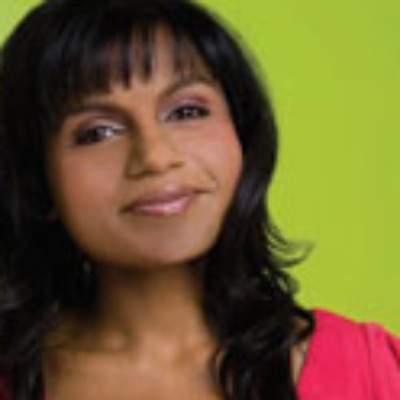

/content/data/val/mindy_kaling/httpcdncdnjustjaredcomwpcontentuploadsheadlinesmindykalingcomedypilotjpg.jpg


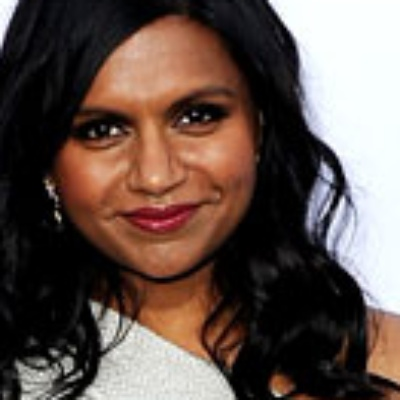

In [ ]:
for imgfolder in os.listdir(valid_path): #iterate thru each of the 5 celeb folders
    for filename in os.listdir(valid_path + imgfolder):# iterate thru each image in a celeb folder
        filename = valid_path + imgfolder + '/' + filename # build the path to the image file
        print(filename) # print the filename read. For debugging purpose only
        img = cv2.imread(filename) # read the image using OpenCV
        try:
          face = cv2.resize(face_extractor(img), (400, 400))
        except:
          face = cv2.resize(img, (400, 400))
        cv2.imwrite(filename, face)
        img = cv2.imread(filename)
        cv2_imshow(img)

In [ ]:
# add preprocessing layer to the front of VGG
vgg = VGG16(input_shape=IMAGE_SIZE + [3], weights='imagenet', include_top=False)

# don't train existing weights
for layer in vgg.layers:
  layer.trainable = False

In [ ]:
folders = glob(train_path+'/*')
print(folders)

['/content/data/train/elton_john', '/content/data/train/madonna', '/content/data/train/jerry_seinfeld', '/content/data/train/ben_afflek', '/content/data/train/mindy_kaling']


In [ ]:
# our layers - you can add more if you want
x = Flatten()(vgg.output)
# x = Dense(1000, activation='relu')(x)
prediction = Dense(len(folders), activation='softmax')(x)

In [ ]:
# create a model object
model = Model(inputs=vgg.input, outputs=prediction)

# view the structure of the model
model.summary()

Model: "model_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         (None, 224, 224, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0   

In [ ]:
# model parameters 
model.compile(
  loss='categorical_crossentropy',
  optimizer='adam',
  metrics=['accuracy']
)

In [ ]:
from keras.preprocessing.image import ImageDataGenerator


In [ ]:
train_datagen = ImageDataGenerator(rescale = 1./255,
                                   shear_range = 0.2,
                                   zoom_range = 0.2,
                                   horizontal_flip = True)

test_datagen = ImageDataGenerator(rescale = 1./255)

In [ ]:
training_set = train_datagen.flow_from_directory(train_path,
                                                 target_size = (224, 224),
                                                 batch_size = 32,
                                                 class_mode = 'categorical')



test_set = test_datagen.flow_from_directory(valid_path,
                                            target_size = (224, 224),
                                            batch_size = 32,
                                            class_mode = 'categorical')


Found 93 images belonging to 5 classes.
Found 25 images belonging to 5 classes.


In [ ]:
# fit the model
r = model.fit_generator(
  training_set,
  validation_data=test_set,
  epochs=5,
  steps_per_epoch=len(training_set),
  validation_steps=len(test_set)
)

Epoch 1/5
3/3 [==============================] - 61s 20s/step - loss: 2.4197 - accuracy: 0.2688 - val_loss: 1.4099 - val_accuracy: 0.4000
Epoch 2/5
3/3 [==============================] - 59s 20s/step - loss: 1.4845 - accuracy: 0.4624 - val_loss: 1.5618 - val_accuracy: 0.4400
Epoch 3/5
3/3 [==============================] - 59s 20s/step - loss: 1.0731 - accuracy: 0.6667 - val_loss: 1.1008 - val_accuracy: 0.5200
Epoch 4/5
3/3 [==============================] - 63s 21s/step - loss: 0.8270 - accuracy: 0.6989 - val_loss: 0.7287 - val_accuracy: 0.6800
Epoch 5/5
3/3 [==============================] - 59s 20s/step - loss: 0.4835 - accuracy: 0.8495 - val_loss: 0.4843 - val_accuracy: 0.8400


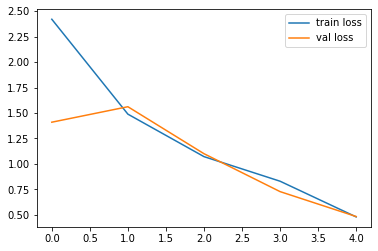

<Figure size 432x288 with 0 Axes>

In [ ]:
#after adding validation set
# loss
plt.plot(r.history['loss'], label='train loss')
plt.plot(r.history['val_loss'], label='val loss')
plt.legend()
plt.show()
plt.savefig('LossVal_loss')



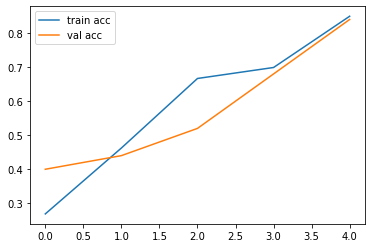

<Figure size 432x288 with 0 Axes>

In [ ]:
# accuracies
plt.plot(r.history['accuracy'], label='train acc')
plt.plot(r.history['val_accuracy'], label='val acc')
plt.legend()
plt.show()
plt.savefig('AccVal_acc')

In [ ]:
model.save('facefeatures_new_model.h5')

PREDICTION

It is elton_john = 100.0%
It is madonna = 3.211892049775054e-25%
It is jerry_seinfeld = 1.7696467555228246e-09%
It is ben_afflek = 1.0613840535633745e-10%
It is mindy_kaling = 1.2836632697765716e-35%


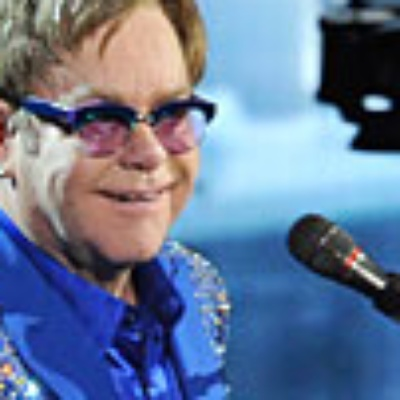

In [ ]:
#enter the location of file to be predicted
img = cv2.imread('/content/data/val/elton_john/httpcdncdnjustjaredcomwpcontentuploadsheadlineseltonjohnemmysperformancewatchnowjpg.jpg')
face=face_extractor(img)
flag=0
if type(face) is np.ndarray:
        face = cv2.resize(face, (224, 224))
        im = Image.fromarray(face, 'RGB')
           #Resizing into 128x128 because we trained the model with this image size.
        img_array = np.array(im)
                    #Our keras model used a 4D tensor, (images x height x width x channel)
                    #So changing dimension 128x128x3 into 1x128x128x3 
        img_array = np.expand_dims(img_array, axis=0)
        pred = model.predict(img_array)
        for i in range (0,len(folders)):
          name=folders[i].split("/")
          name=name[-1]
          print("It is "+name+" = "+str(pred[0][i]*100)+"%")
          flag=1

cv2_imshow(img)
if(flag==0):
  print("no one detected")
        

USED FOR TAKING PIC FROM WEB CAM (if needed)

I am Using GoogleColab's Js script for capturing 1 pic from webcam which we will predict

In [ ]:
from IPython.display import display, Javascript
from google.colab.output import eval_js
from base64 import b64decode

def take_photo(filename='photo.jpg', quality=0.8):
  js = Javascript('''
    async function takePhoto(quality) {
      const div = document.createElement('div');
      const capture = document.createElement('button');
      capture.textContent = 'Capture';
      div.appendChild(capture);

      const video = document.createElement('video');
      video.style.display = 'block';
      const stream = await navigator.mediaDevices.getUserMedia({video: true});

      document.body.appendChild(div);
      div.appendChild(video);
      video.srcObject = stream;
      await video.play();

      // Resize the output to fit the video element.
      google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

      // Wait for Capture to be clicked.
      await new Promise((resolve) => capture.onclick = resolve);

      const canvas = document.createElement('canvas');
      canvas.width = video.videoWidth;
      canvas.height = video.videoHeight;
      canvas.getContext('2d').drawImage(video, 0, 0);
      stream.getVideoTracks()[0].stop();
      div.remove();
      return canvas.toDataURL('image/jpeg', quality);
    }
    ''')
  display(js)
  data = eval_js('takePhoto({})'.format(quality))
  binary = b64decode(data.split(',')[1])
  with open(filename, 'wb') as f:
    f.write(binary)
  return filename

In [ ]:
from IPython.display import Image
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  
  # Show the image which was just taken.
  display(Image(filename))
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))